## Practical Work 1

Develop a Python program that is able to implement the gradient descent in order to achieve the linear regression (Single and Multivariables) of a set of datapoints.

#### Import numpy, matplotlib.pyplot and any library you will need

In [1]:
import numpy as np
import matplotlib.pyplot as plt 
%matplotlib inline

In [85]:
from sklearn.metrics import r2_score

#### Read RegData csv file into numpy array 

In [2]:
data = np.genfromtxt('RegData.csv',delimiter=',')

In [3]:
data

array([[2.9000001 , 4.        ],
       [6.69999981, 7.4000001 ],
       [4.9000001 , 5.        ],
       [7.9000001 , 7.19999981],
       [9.80000019, 7.9000001 ],
       [6.9000001 , 6.0999999 ],
       [6.0999999 , 6.        ],
       [6.19999981, 5.80000019],
       [6.        , 5.19999981],
       [5.0999999 , 4.19999981],
       [4.69999981, 4.        ],
       [4.4000001 , 4.4000001 ],
       [5.80000019, 5.19999981]])

#### Define variables X and y. 
#### Assign first column data to X and second column to y
<b>Note:</b> X is the independent variable (input to LR model) and y is the dependent variable (output)

In [4]:
X = data[:,0]
y = data[:,1]

#### Explore your data

In [5]:
X

array([2.9000001 , 6.69999981, 4.9000001 , 7.9000001 , 9.80000019,
       6.9000001 , 6.0999999 , 6.19999981, 6.        , 5.0999999 ,
       4.69999981, 4.4000001 , 5.80000019])

In [6]:
y

array([4.        , 7.4000001 , 5.        , 7.19999981, 7.9000001 ,
       6.0999999 , 6.        , 5.80000019, 5.19999981, 4.19999981,
       4.        , 4.4000001 , 5.19999981])

#### Plot the original data (scatter plot of X,y)

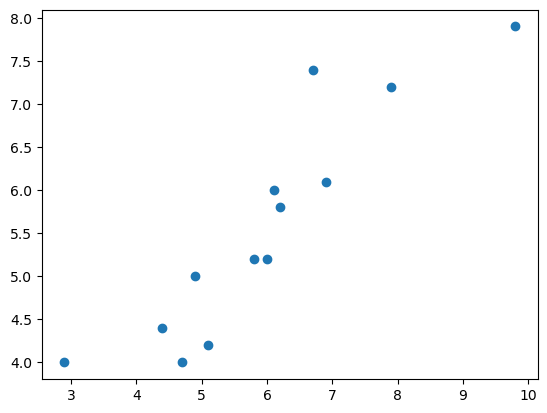

In [7]:
plt.scatter(X,y)
plt.show()

## LR Full Implementation

### Step1: Initialize parameters (theta_0 & theta_1) with random value or simply zero. Also choose the Learning rate.

In [48]:
theta_0 = 0
theta_1 = 0
learning_rate = 0.0001

### Step2: Use (theta_0 & theta_1) to predict the output h(x)= theta_0 + theta_1 * x.

In [41]:
predicted_y = theta_0 + theta_1 * X
print('h(X):', predicted_y)

h(X): [0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]


### Step3: Calculate the MSE Cost function 𝑱(theta_0,theta_1 ).
<b>Note:</b> You better use either dot product or norm square of the error vector.

In [42]:
error_vector = predicted_y - y
print('Error Vector:\n', error_vector)

mse = np.square(error_vector).mean() / 2
print('\nj =', mse)

Error Vector:
 [-4.         -7.4000001  -5.         -7.19999981 -7.9000001  -6.0999999
 -6.         -5.80000019 -5.19999981 -4.19999981 -4.         -4.4000001
 -5.19999981]

j = 16.305384479692318


### Step4: Calculate the gradient components for theta_0 and theta_1.
<b>Note:</b> You can use the error vector calculated in the previous step.

In [43]:
m =len(y)
m

13

In [44]:
d_theta_0 = (1/m)*np.sum(error_vector)
print("d_theta_0 :", d_theta_0)

d_theta_1 = (1/m)*np.sum(error_vector*X)
print("d_theta_1 :", d_theta_1)

d_theta_0 : -5.569230739769231
d_theta_1 : -35.043846043215375


### Step5: Update the parameters (simultaneously).

In [49]:
theta_0 = theta_0 - learning_rate * d_theta_0
print("theta_0_new :", theta_0)

theta_1 = theta_1 - learning_rate * d_theta_1
print("theta_1_new :", theta_1)

theta_0_new : 0.0005569230739769231
theta_1_new : 0.003504384604321538


### Step6: Repeat from 2 to 5 until converge to the minimum or achieve maximum iterations.
#### The objective from this step is to combine all the previous steps and iterate untill you either achieve the maximum number of iterations or reach the minimum.

In [70]:
theta_0 = 0
theta_1 = 0
learning_rate = 0.01

for i in range(1000):
    print(f"****************** Iteration {i} ********************\n")
    predicted_y = theta_0 + theta_1 * X
    print('h(X):', predicted_y)

    error_vector = predicted_y - y
    print('\nError Vector:\n', error_vector)

    mse = np.square(error_vector).mean() / 2
    print('\nj =', mse)

    m =len(y)
    d_theta_0 = (1/m)*np.sum(error_vector)
    d_theta_1 = (1/m)*np.sum(error_vector*X)
    
    vector = np.array([d_theta_0, d_theta_1])
    print("\nGradient Vector:\n", vector)
    vector_norm = np.linalg.norm(vector)
    print("\nGradient Vector Norm:\n", vector_norm)

    theta_0 = theta_0 - learning_rate * d_theta_0
    print("\ntheta_0_new :", theta_0)

    theta_1 = theta_1 - learning_rate * d_theta_1
    print("theta_1_new :", theta_1)

    

****************** Iteration 0 ********************

h(X): [0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]

Error Vector:
 [-4.         -7.4000001  -5.         -7.19999981 -7.9000001  -6.0999999
 -6.         -5.80000019 -5.19999981 -4.19999981 -4.         -4.4000001
 -5.19999981]

j = 16.305384479692318

Gradient Vector:
 [ -5.56923074 -35.04384604]

Gradient Vector Norm:
 35.483622652335995

theta_0_new : 0.05569230739769231
theta_1_new : 0.35043846043215376
****************** Iteration 1 ********************

h(X): [1.07196388 2.40362993 1.7728408  2.82415618 3.48998929 2.47371772
 2.19336688 2.2284107  2.15832307 1.84292842 1.702753   1.59762157
 2.08823544]

Error Vector:
 [-2.92803612 -4.99637017 -3.2271592  -4.37584363 -4.41001081 -3.62628219
 -3.80663312 -3.5715895  -3.04167674 -2.35707139 -2.297247   -2.80237853
 -3.11176436]

j = 6.175608808043304

Gradient Vector:
 [ -3.42708175 -21.33845263]

Gradient Vector Norm:
 21.611905283072655

theta_0_new : 0.08996312489803085
theta_1_new :

In [81]:
theta_0 = 0
theta_1 = 0
learning_rate = 0.01
n_iter = 1000
stopping_threshold = 0.1

for i in range(n_iter):
    print(f"****************** Iteration {i} ********************\n")
    predicted_y = theta_0 + theta_1 * X
    print('h(X):', predicted_y)

    error_vector = predicted_y - y
    print('\nError Vector:\n', error_vector)

    mse = np.square(error_vector).mean() / 2
    print('\nj =', mse)

    m =len(y)
    d_theta_0 = (1/m)*np.sum(error_vector)
    d_theta_1 = (1/m)*np.sum(error_vector*X)
    
    grad_vector = np.array([d_theta_0, d_theta_1])
    print("\nGradient Vector:\n", grad_vector)
    grad_vector_norm = np.linalg.norm(grad_vector)
    print("\nGradient Vector Norm:\n", grad_vector_norm)

    if grad_vector_norm <= stopping_threshold:
        print("****************** Training Report ********************\n")
        print(f"Gradient Descent converged after {i} iterations")
        print("\ntheta_0_new :", theta_0)
        print("theta_1_new :", theta_1)
        print('\nError Vector:\n', error_vector)
        print('\ncost =', mse)
        print('\nh(x) = y_predict:\n', predicted_y)
        print("\ny_actual:\n", y)
        break

    theta_0 = theta_0 - learning_rate * d_theta_0
    print("\ntheta_0_new :", theta_0)

    theta_1 = theta_1 - learning_rate * d_theta_1
    print("theta_1_new :", theta_1)

****************** Iteration 0 ********************

h(X): [0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]

Error Vector:
 [-4.         -7.4000001  -5.         -7.19999981 -7.9000001  -6.0999999
 -6.         -5.80000019 -5.19999981 -4.19999981 -4.         -4.4000001
 -5.19999981]

j = 16.305384479692318

Gradient Vector:
 [ -5.56923074 -35.04384604]

Gradient Vector Norm:
 35.483622652335995

theta_0_new : 0.05569230739769231
theta_1_new : 0.35043846043215376
****************** Iteration 1 ********************

h(X): [1.07196388 2.40362993 1.7728408  2.82415618 3.48998929 2.47371772
 2.19336688 2.2284107  2.15832307 1.84292842 1.702753   1.59762157
 2.08823544]

Error Vector:
 [-2.92803612 -4.99637017 -3.2271592  -4.37584363 -4.41001081 -3.62628219
 -3.80663312 -3.5715895  -3.04167674 -2.35707139 -2.297247   -2.80237853
 -3.11176436]

j = 6.175608808043304

Gradient Vector:
 [ -3.42708175 -21.33845263]

Gradient Vector Norm:
 21.611905283072655

theta_0_new : 0.08996312489803085
theta_1_new :

#### Predict y values using the LR equation
##### h(x)= theta_0 + theta_1 * x

In [82]:
y_predict_LR = theta_0 + theta_1 * X
print('\nh(x) = y_predict:\n', y_predict_LR)
print("\ny_actual:\n", y)


h(x) = y_predict:
 [2.74498295 6.14196626 4.53286904 7.21469817 8.91319004 6.32075512
 5.60560052 5.69499474 5.5162063  4.71165748 4.35408017 4.08589751
 5.33741786]

y_actual:
 [4.         7.4000001  5.         7.19999981 7.9000001  6.0999999
 6.         5.80000019 5.19999981 4.19999981 4.         4.4000001
 5.19999981]


#### Plot  LR equation output (fitted line) with the original data (scatter plot of X,y)

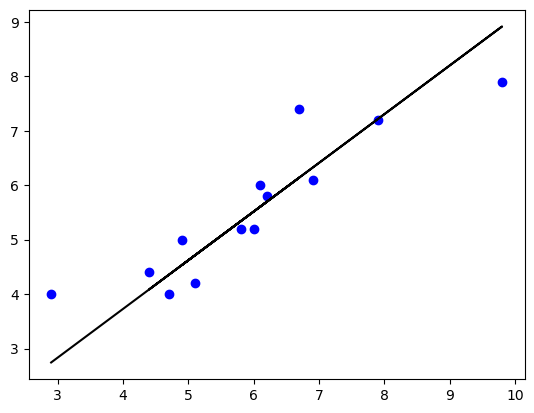

In [84]:
plt.scatter(X,y, color='b')
plt.plot(X, predicted_y ,color='k')

#### Use R2 score to evaluate LR equation output
https://www.youtube.com/watch?v=KccCy0hu-dM

In [86]:
r2_score(y, predicted_y)

0.7480324921408193

In [95]:
theta_0 = 0
theta_1 = 0
learning_rate = 0.0001
n_iter = 10000
stopping_threshold = 0.1

for i in range(n_iter):
    print(f"****************** Iteration {i} ********************\n")
    predicted_y = theta_0 + theta_1 * X
    print('h(X):', predicted_y)

    error_vector = predicted_y - y
    print('\nError Vector:\n', error_vector)

    mse = np.square(error_vector).mean() / 2
    print('\nj =', mse)

    m =len(y)
    d_theta_0 = (1/m)*np.sum(error_vector)
    d_theta_1 = (1/m)*np.sum(error_vector*X)
    
    grad_vector = np.array([d_theta_0, d_theta_1])
    print("\nGradient Vector:\n", grad_vector)
    grad_vector_norm = np.linalg.norm(grad_vector)
    print("\nGradient Vector Norm:\n", grad_vector_norm)

    if grad_vector_norm <= stopping_threshold:
        print("****************** Training Report ********************\n")
        print(f"Gradient Descent converged after {i} iterations")
        print("\ntheta_0_new :", theta_0)
        print("theta_1_new :", theta_1)
        print('\nError Vector:\n', error_vector)
        print('\ncost =', mse)
        print('\nh(x) = y_predict:\n', predicted_y)
        print("\ny_actual:\n", y)
        break

    theta_0 = theta_0 - learning_rate * d_theta_0
    print("\ntheta_0_new :", theta_0)

    theta_1 = theta_1 - learning_rate * d_theta_1
    print("theta_1_new :", theta_1)

****************** Iteration 0 ********************

h(X): [0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]

Error Vector:
 [-4.         -7.4000001  -5.         -7.19999981 -7.9000001  -6.0999999
 -6.         -5.80000019 -5.19999981 -4.19999981 -4.         -4.4000001
 -5.19999981]

j = 16.305384479692318

Gradient Vector:
 [ -5.56923074 -35.04384604]

Gradient Vector Norm:
 35.483622652335995

theta_0_new : 0.0005569230739769231
theta_1_new : 0.003504384604321538
****************** Iteration 1 ********************

h(X): [0.01071964 0.0240363  0.01772841 0.02824156 0.03489989 0.02473718
 0.02193367 0.02228411 0.02158323 0.01842928 0.01702753 0.01597622
 0.02088235]

Error Vector:
 [-3.98928036 -7.3759638  -4.98227159 -7.17175825 -7.8651002  -6.07526273
 -5.97806633 -5.77771608 -5.17841658 -4.18157052 -3.98297247 -4.38402388
 -5.17911745]

j = 16.179721841948346

Gradient Vector:
 [ -5.54780925 -34.90679211]

Gradient Vector Norm:
 35.344905189004606

theta_0_new : 0.001111703998964111
theta_1_

In [96]:
r2_score(y, predicted_y)

0.7483349204561898

In [112]:
theta_0 = 0
theta_1 = 0
learning_rate = 0.001
n_iter = 10000
stopping_threshold = 0.2

for i in range(n_iter):
    print(f"****************** Iteration {i} ********************\n")
    predicted_y = theta_0 + theta_1 * X
    print('h(X):', predicted_y)

    error_vector = predicted_y - y
    print('\nError Vector:\n', error_vector)

    mse = np.square(error_vector).mean() / 2
    print('\nj =', mse)

    m =len(y)
    d_theta_0 = (1/m)*np.sum(error_vector)
    d_theta_1 = (1/m)*np.sum(error_vector*X)
    
    grad_vector = np.array([d_theta_0, d_theta_1])
    print("\nGradient Vector:\n", grad_vector)
    grad_vector_norm = np.linalg.norm(grad_vector)
    print("\nGradient Vector Norm:\n", grad_vector_norm)

    if grad_vector_norm <= stopping_threshold:
        print("****************** Training Report ********************\n")
        print(f"Gradient Descent converged after {i} iterations")
        print("\ntheta_0_new :", theta_0)
        print("theta_1_new :", theta_1)
        print('\nError Vector:\n', error_vector)
        print('\ncost =', mse)
        print('\nh(x) = y_predict:\n', predicted_y)
        print("\ny_actual:\n", y)
        break

    theta_0 = theta_0 - learning_rate * d_theta_0
    print("\ntheta_0_new :", theta_0)

    theta_1 = theta_1 - learning_rate * d_theta_1
    print("theta_1_new :", theta_1)

****************** Iteration 0 ********************

h(X): [0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]

Error Vector:
 [-4.         -7.4000001  -5.         -7.19999981 -7.9000001  -6.0999999
 -6.         -5.80000019 -5.19999981 -4.19999981 -4.         -4.4000001
 -5.19999981]

j = 16.305384479692318

Gradient Vector:
 [ -5.56923074 -35.04384604]

Gradient Vector Norm:
 35.483622652335995

theta_0_new : 0.005569230739769231
theta_1_new : 0.03504384604321537
****************** Iteration 1 ********************

h(X): [0.10719639 0.24036299 0.17728408 0.28241562 0.34899893 0.24737177
 0.21933669 0.22284107 0.21583231 0.18429284 0.1702753  0.15976216
 0.20882354]

Error Vector:
 [-3.89280361 -7.1596371  -4.82271592 -6.91758419 -7.55100117 -5.85262813
 -5.78066331 -5.57715912 -4.9841675  -4.01570697 -3.8297247  -4.24023794
 -4.99117626]

j = 15.070907994095792

Gradient Vector:
 [ -5.35501584 -33.6733067 ]

Gradient Vector Norm:
 34.09644818591864

theta_0_new : 0.010924246580564925
theta_1_new

In [113]:
r2_score(y, predicted_y)

0.7474801924517174

In [130]:
theta_0 = 0
theta_1 = 0
learning_rate = 0.01
n_iter = 10000
stopping_threshold = 0.0001

for i in range(n_iter):
    print(f"****************** Iteration {i} ********************\n")
    predicted_y = theta_0 + theta_1 * X
    print('h(X):', predicted_y)

    error_vector = predicted_y - y
    print('\nError Vector:\n', error_vector)

    mse = np.square(error_vector).mean() / 2
    print('\nj =', mse)

    m =len(y)
    d_theta_0 = (1/m)*np.sum(error_vector)
    d_theta_1 = (1/m)*np.sum(error_vector*X)
    
    grad_vector = np.array([d_theta_0, d_theta_1])
    print("\nGradient Vector:\n", grad_vector)
    grad_vector_norm = np.linalg.norm(grad_vector)
    print("\nGradient Vector Norm:\n", grad_vector_norm)

    if grad_vector_norm <= stopping_threshold:
        print("****************** Training Report ********************\n")
        print(f"Gradient Descent converged after {i} iterations")
        print("\ntheta_0_new :", theta_0)
        print("theta_1_new :", theta_1)
        print('\nError Vector:\n', error_vector)
        print('\ncost =', mse)
        print('\nh(x) = y_predict:\n', predicted_y)
        print("\ny_actual:\n", y)
        break

    theta_0 = theta_0 - learning_rate * d_theta_0
    print("\ntheta_0_new :", theta_0)

    theta_1 = theta_1 - learning_rate * d_theta_1
    print("theta_1_new :", theta_1)

****************** Iteration 0 ********************

h(X): [0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]

Error Vector:
 [-4.         -7.4000001  -5.         -7.19999981 -7.9000001  -6.0999999
 -6.         -5.80000019 -5.19999981 -4.19999981 -4.         -4.4000001
 -5.19999981]

j = 16.305384479692318

Gradient Vector:
 [ -5.56923074 -35.04384604]

Gradient Vector Norm:
 35.483622652335995

theta_0_new : 0.05569230739769231
theta_1_new : 0.35043846043215376
****************** Iteration 1 ********************

h(X): [1.07196388 2.40362993 1.7728408  2.82415618 3.48998929 2.47371772
 2.19336688 2.2284107  2.15832307 1.84292842 1.702753   1.59762157
 2.08823544]

Error Vector:
 [-2.92803612 -4.99637017 -3.2271592  -4.37584363 -4.41001081 -3.62628219
 -3.80663312 -3.5715895  -3.04167674 -2.35707139 -2.297247   -2.80237853
 -3.11176436]

j = 6.175608808043304

Gradient Vector:
 [ -3.42708175 -21.33845263]

Gradient Vector Norm:
 21.611905283072655

theta_0_new : 0.08996312489803085
theta_1_new :

In [131]:
r2_score(y, predicted_y)

0.8213155876124152

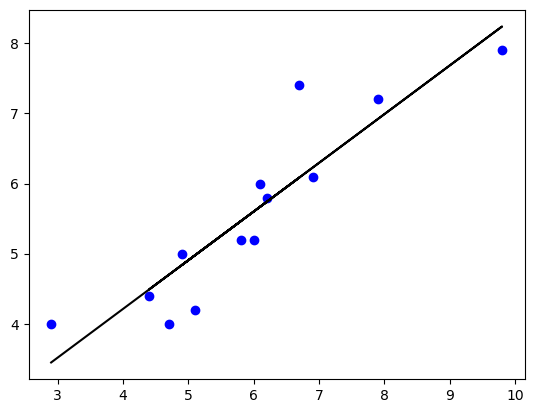

In [132]:
plt.scatter(X,y, color='b')
plt.plot(X, predicted_y ,color='k')

## Plot loss function
### Repeat your implementaion version and save loss for each iteration (epoch)

In [134]:
theta_0 = 0
theta_1 = 0
learning_rate = 0.01
n_iter = 1000
stopping_threshold = 0.1
ls_loss = []

for i in range(n_iter):
    print(f"****************** Iteration {i} ********************\n")
    predicted_y = theta_0 + theta_1 * X
    print('h(X):', predicted_y)

    error_vector = predicted_y - y
    print('\nError Vector:\n', error_vector)

    mse = np.square(error_vector).mean() / 2
    print('\nj =', mse)
    ls_loss.append(mse)

    m =len(y)
    d_theta_0 = (1/m)*np.sum(error_vector)
    d_theta_1 = (1/m)*np.sum(error_vector*X)
    
    grad_vector = np.array([d_theta_0, d_theta_1])
    print("\nGradient Vector:\n", grad_vector)
    grad_vector_norm = np.linalg.norm(grad_vector)
    print("\nGradient Vector Norm:\n", grad_vector_norm)

    if grad_vector_norm <= stopping_threshold:
        print("****************** Training Report ********************\n")
        print(f"Gradient Descent converged after {i} iterations")
        print("\ntheta_0_new :", theta_0)
        print("theta_1_new :", theta_1)
        print('\nError Vector:\n', error_vector)
        print('\ncost =', mse)
        print('\nh(x) = y_predict:\n', predicted_y)
        print("\ny_actual:\n", y)
        break

    theta_0 = theta_0 - learning_rate * d_theta_0
    print("\ntheta_0_new :", theta_0)

    theta_1 = theta_1 - learning_rate * d_theta_1
    print("theta_1_new :", theta_1)

****************** Iteration 0 ********************

h(X): [0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]

Error Vector:
 [-4.         -7.4000001  -5.         -7.19999981 -7.9000001  -6.0999999
 -6.         -5.80000019 -5.19999981 -4.19999981 -4.         -4.4000001
 -5.19999981]

j = 16.305384479692318

Gradient Vector:
 [ -5.56923074 -35.04384604]

Gradient Vector Norm:
 35.483622652335995

theta_0_new : 0.05569230739769231
theta_1_new : 0.35043846043215376
****************** Iteration 1 ********************

h(X): [1.07196388 2.40362993 1.7728408  2.82415618 3.48998929 2.47371772
 2.19336688 2.2284107  2.15832307 1.84292842 1.702753   1.59762157
 2.08823544]

Error Vector:
 [-2.92803612 -4.99637017 -3.2271592  -4.37584363 -4.41001081 -3.62628219
 -3.80663312 -3.5715895  -3.04167674 -2.35707139 -2.297247   -2.80237853
 -3.11176436]

j = 6.175608808043304

Gradient Vector:
 [ -3.42708175 -21.33845263]

Gradient Vector Norm:
 21.611905283072655

theta_0_new : 0.08996312489803085
theta_1_new :

### Plot loss vs. iterations

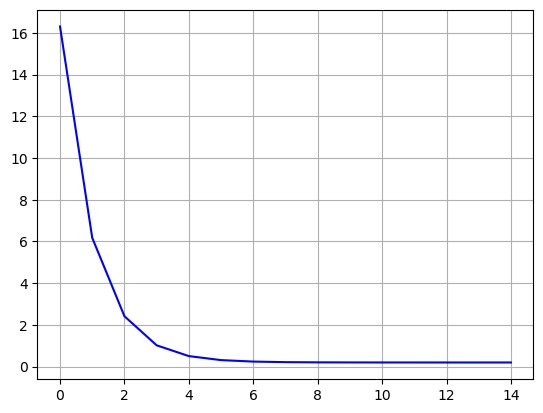

In [140]:
plt.plot(ls_loss, color='b')
plt.grid()

## Multivariate LR

#### Read MultiVarLR csv file into numpy array.
#### The first three columns are x1,x2, and x3.
#### The last column is the target label y.

In [231]:
data2 = np.genfromtxt('MultiVarLR.csv',delimiter=',')

In [233]:
data2

array([[ 73.,  80.,  75., 152.],
       [ 93.,  88.,  93., 185.],
       [ 89.,  91.,  90., 180.],
       [ 96.,  98., 100., 196.],
       [ 73.,  66.,  70., 142.],
       [ 53.,  46.,  55., 101.],
       [ 69.,  74.,  77., 149.],
       [ 47.,  56.,  60., 115.],
       [ 87.,  79.,  90., 175.],
       [ 79.,  70.,  88., 164.],
       [ 69.,  70.,  73., 141.],
       [ 70.,  65.,  74., 141.],
       [ 93.,  95.,  91., 184.],
       [ 79.,  80.,  73., 152.],
       [ 70.,  73.,  78., 148.],
       [ 93.,  89.,  96., 192.],
       [ 78.,  75.,  68., 147.],
       [ 81.,  90.,  93., 183.],
       [ 88.,  92.,  86., 177.],
       [ 78.,  83.,  77., 159.],
       [ 82.,  86.,  90., 177.],
       [ 86.,  82.,  89., 175.],
       [ 78.,  83.,  85., 175.],
       [ 76.,  83.,  71., 149.],
       [ 96.,  93.,  95., 192.]])

In [234]:
X2 = data2[:,:3]
X2

array([[ 73.,  80.,  75.],
       [ 93.,  88.,  93.],
       [ 89.,  91.,  90.],
       [ 96.,  98., 100.],
       [ 73.,  66.,  70.],
       [ 53.,  46.,  55.],
       [ 69.,  74.,  77.],
       [ 47.,  56.,  60.],
       [ 87.,  79.,  90.],
       [ 79.,  70.,  88.],
       [ 69.,  70.,  73.],
       [ 70.,  65.,  74.],
       [ 93.,  95.,  91.],
       [ 79.,  80.,  73.],
       [ 70.,  73.,  78.],
       [ 93.,  89.,  96.],
       [ 78.,  75.,  68.],
       [ 81.,  90.,  93.],
       [ 88.,  92.,  86.],
       [ 78.,  83.,  77.],
       [ 82.,  86.,  90.],
       [ 86.,  82.,  89.],
       [ 78.,  83.,  85.],
       [ 76.,  83.,  71.],
       [ 96.,  93.,  95.]])

In [235]:
y2 = data2[:,3]
y2 = y2.reshape(-1,1)
y2

array([[152.],
       [185.],
       [180.],
       [196.],
       [142.],
       [101.],
       [149.],
       [115.],
       [175.],
       [164.],
       [141.],
       [141.],
       [184.],
       [152.],
       [148.],
       [192.],
       [147.],
       [183.],
       [177.],
       [159.],
       [177.],
       [175.],
       [175.],
       [149.],
       [192.]])

In [236]:
y2

array([[152.],
       [185.],
       [180.],
       [196.],
       [142.],
       [101.],
       [149.],
       [115.],
       [175.],
       [164.],
       [141.],
       [141.],
       [184.],
       [152.],
       [148.],
       [192.],
       [147.],
       [183.],
       [177.],
       [159.],
       [177.],
       [175.],
       [175.],
       [149.],
       [192.]])

### Generalize your implementation to work for MultiVariables
#### Vectorize your implementation.
<b>Notes:</b> 
- You need to add column that contains ones to the data. This column represent x feature for theta_0.
- Use learninig rate = 0.0001.

In [237]:
m = len(y2)
X0 = np.ones((m,1))
X2 = np.hstack((X0,X2))
X2

array([[  1.,  73.,  80.,  75.],
       [  1.,  93.,  88.,  93.],
       [  1.,  89.,  91.,  90.],
       [  1.,  96.,  98., 100.],
       [  1.,  73.,  66.,  70.],
       [  1.,  53.,  46.,  55.],
       [  1.,  69.,  74.,  77.],
       [  1.,  47.,  56.,  60.],
       [  1.,  87.,  79.,  90.],
       [  1.,  79.,  70.,  88.],
       [  1.,  69.,  70.,  73.],
       [  1.,  70.,  65.,  74.],
       [  1.,  93.,  95.,  91.],
       [  1.,  79.,  80.,  73.],
       [  1.,  70.,  73.,  78.],
       [  1.,  93.,  89.,  96.],
       [  1.,  78.,  75.,  68.],
       [  1.,  81.,  90.,  93.],
       [  1.,  88.,  92.,  86.],
       [  1.,  78.,  83.,  77.],
       [  1.,  82.,  86.,  90.],
       [  1.,  86.,  82.,  89.],
       [  1.,  78.,  83.,  85.],
       [  1.,  76.,  83.,  71.],
       [  1.,  96.,  93.,  95.]])

In [238]:
y2.shape, X2.shape, theta_n.shape, gradient.shape, predicted_y2.shape, error.shape

((25, 1), (25, 4), (4, 1), (4, 1), (25, 1), (25, 1))

In [239]:
predicted_y2

array([[152.93271151],
       [184.61231886],
       [181.38322157],
       [198.85544308],
       [139.90499943],
       [105.25867203],
       [150.57363082],
       [114.01431493],
       [174.32084699],
       [164.43562114],
       [143.95734843],
       [142.79946086],
       [186.06153677],
       [152.83944858],
       [151.53012506],
       [188.51733974],
       [144.20948104],
       [181.35413506],
       [177.0503019 ],
       [158.56752095],
       [176.22294238],
       [174.42154366],
       [167.57132207],
       [151.09544099],
       [190.5850901 ]])

In [240]:
X2 @ theta_n

array([[152.93271151],
       [184.61231886],
       [181.38322157],
       [198.85544308],
       [139.90499943],
       [105.25867203],
       [150.57363082],
       [114.01431493],
       [174.32084699],
       [164.43562114],
       [143.95734843],
       [142.79946086],
       [186.06153677],
       [152.83944858],
       [151.53012506],
       [188.51733974],
       [144.20948104],
       [181.35413506],
       [177.0503019 ],
       [158.56752095],
       [176.22294238],
       [174.42154366],
       [167.57132207],
       [151.09544099],
       [190.5850901 ]])

In [241]:
theta_n

array([[-0.01742329],
       [ 0.35961456],
       [ 0.52859546],
       [ 1.12547514]])

In [242]:
learning_rate = 0.0001
n_iter = 10000
stopping_threshold = 0.1
theta_n = np.zeros((X2.shape[1],1))

for i in range(n_iter):
    print(f"****************** Iteration {i} ********************\n")
    predicted_y2 = X2 @ theta_n
    print(predicted_y2)
    print('h(X):', predicted_y2)

    error = predicted_y2 - y2
    error = error
    print('\nError Vector:\n', error)
    m =len(y2)

    # mse = np.square(error).mean() / 2
    mse = np.dot(error.T, error) / (2 * m)
    print('\nj =', mse)


    gradient = ((X2.T) @ error) / m
    print("\nGradient Vector:\n", gradient)
    grad_norm = np.linalg.norm(gradient)
    print("\nGradient Vector Norm:\n", grad_norm)

    if grad_norm < stopping_threshold:
        print("****************** Training Report ********************\n")
        print(f"Gradient Descent converged after {i} iterations")
        print("theta_1_new :", theta_n)
        print('\nError Vector:\n', error_vector)
        print('\ncost =', mse)
        print('\nh(x) = y2_predict:\n', predicted_y2)
        print("\ny_actual:\n", y2)
        break

    theta_n = theta_n - learning_rate * gradient
    print("\ntheta_n_new :", theta_n)

****************** Iteration 0 ********************

[[0.]
 [0.]
 [0.]
 [0.]
 [0.]
 [0.]
 [0.]
 [0.]
 [0.]
 [0.]
 [0.]
 [0.]
 [0.]
 [0.]
 [0.]
 [0.]
 [0.]
 [0.]
 [0.]
 [0.]
 [0.]
 [0.]
 [0.]
 [0.]
 [0.]]
h(X): [[0.]
 [0.]
 [0.]
 [0.]
 [0.]
 [0.]
 [0.]
 [0.]
 [0.]
 [0.]
 [0.]
 [0.]
 [0.]
 [0.]
 [0.]
 [0.]
 [0.]
 [0.]
 [0.]
 [0.]
 [0.]
 [0.]
 [0.]
 [0.]
 [0.]]

Error Vector:
 [[-152.]
 [-185.]
 [-180.]
 [-196.]
 [-142.]
 [-101.]
 [-149.]
 [-115.]
 [-175.]
 [-164.]
 [-141.]
 [-141.]
 [-184.]
 [-152.]
 [-148.]
 [-192.]
 [-147.]
 [-183.]
 [-177.]
 [-159.]
 [-177.]
 [-175.]
 [-175.]
 [-149.]
 [-192.]]

j = [[13405.98]]

Gradient Vector:
 [[  -162.04]
 [-13075.8 ]
 [-13147.2 ]
 [-13467.08]]

Gradient Vector Norm:
 22917.5459892197

theta_n_new : [[0.016204]
 [1.30758 ]
 [1.31472 ]
 [1.346708]]
****************** Iteration 1 ********************

[[301.650244]
 [362.560348]
 [357.234064]
 [389.057244]
 [276.510624]
 [203.864004]
 [291.22502 ]
 [215.899264]
 [338.842264]
 [313.855728]
 [280.579

#### Predict y values using the LR equation 
##### X@thetas

In [214]:
y2_predict_LR = X2 @ theta_n
print("h(x) = y_predict:", y2_predict_LR)

h(x) = y_predict: [[152.93271151]
 [184.61231886]
 [181.38322157]
 [198.85544308]
 [139.90499943]
 [105.25867203]
 [150.57363082]
 [114.01431493]
 [174.32084699]
 [164.43562114]
 [143.95734843]
 [142.79946086]
 [186.06153677]
 [152.83944858]
 [151.53012506]
 [188.51733974]
 [144.20948104]
 [181.35413506]
 [177.0503019 ]
 [158.56752095]
 [176.22294238]
 [174.42154366]
 [167.57132207]
 [151.09544099]
 [190.5850901 ]]


h(x) = y_predict:
[[152.91099637]
 [184.64281272]
 [181.38446819]
 [198.8431854 ]
 [139.95522625]
 [105.2845922 ]
 [150.53085163]
 [113.93318063]
 [174.34754891]
 [164.43754799]
 [143.94704015]
 [142.81011161]
 [186.07691277]
 [152.87604883]
 [151.4943701 ]
 [188.53044781]
 [144.27849537]
 [181.27956687]
 [177.05842637]
 [158.56695943]
 [176.18438562]
 [174.43425395]
 [167.53368834]
 [151.10633452]
 [190.61342106]]

y:
[[152.]
 [185.]
 [180.]
 [196.]
 [142.]
 [101.]
 [149.]
 [115.]
 [175.]
 [164.]
 [141.]
 [141.]
 [184.]
 [152.]
 [148.]
 [192.]
 [147.]
 [183.]
 [177.]
 [159.]
 [177.]
 [175.]
 [175.]
 [149.]
 [192.]]



### Plot loss vs. iterations

In [248]:
learning_rate = 0.0001
n_iter = 10000
stopping_threshold = 0.1
theta_n = np.zeros((X2.shape[1],1))
losses = []

for i in range(n_iter):
    print(f"****************** Iteration {i} ********************\n")
    predicted_y2 = X2 @ theta_n
    print(predicted_y2)
    print('h(X):', predicted_y2)

    error = predicted_y2 - y2
    error = error
    print('\nError Vector:\n', error)
    m =len(y2)

    # mse = np.square(error).mean() / 2
    # mse = np.dot(error.T, error) / (2 * m)
    mse = np.sum(error**2) / (2 * m)
    print('\nj =', mse)
    # losses.append(mse[0][0])
    losses.append(mse)

    gradient = ((X2.T) @ error) / m
    print("\nGradient Vector:\n", gradient)
    grad_norm = np.linalg.norm(gradient)
    print("\nGradient Vector Norm:\n", grad_norm)

    if grad_norm < stopping_threshold:
        print("****************** Training Report ********************\n")
        print(f"Gradient Descent converged after {i} iterations")
        print("theta_1_new :", theta_n)
        print('\nError Vector:\n', error_vector)
        print('\ncost =', mse)
        print('\nh(x) = y2_predict:\n', predicted_y2)
        print("\ny_actual:\n", y2)
        break

    theta_n = theta_n - learning_rate * gradient
    print("\ntheta_n_new :", theta_n)

****************** Iteration 0 ********************

[[0.]
 [0.]
 [0.]
 [0.]
 [0.]
 [0.]
 [0.]
 [0.]
 [0.]
 [0.]
 [0.]
 [0.]
 [0.]
 [0.]
 [0.]
 [0.]
 [0.]
 [0.]
 [0.]
 [0.]
 [0.]
 [0.]
 [0.]
 [0.]
 [0.]]
h(X): [[0.]
 [0.]
 [0.]
 [0.]
 [0.]
 [0.]
 [0.]
 [0.]
 [0.]
 [0.]
 [0.]
 [0.]
 [0.]
 [0.]
 [0.]
 [0.]
 [0.]
 [0.]
 [0.]
 [0.]
 [0.]
 [0.]
 [0.]
 [0.]
 [0.]]

Error Vector:
 [[-152.]
 [-185.]
 [-180.]
 [-196.]
 [-142.]
 [-101.]
 [-149.]
 [-115.]
 [-175.]
 [-164.]
 [-141.]
 [-141.]
 [-184.]
 [-152.]
 [-148.]
 [-192.]
 [-147.]
 [-183.]
 [-177.]
 [-159.]
 [-177.]
 [-175.]
 [-175.]
 [-149.]
 [-192.]]

j = 13405.98

Gradient Vector:
 [[  -162.04]
 [-13075.8 ]
 [-13147.2 ]
 [-13467.08]]

Gradient Vector Norm:
 22917.5459892197

theta_n_new : [[0.016204]
 [1.30758 ]
 [1.31472 ]
 [1.346708]]
****************** Iteration 1 ********************

[[301.650244]
 [362.560348]
 [357.234064]
 [389.057244]
 [276.510624]
 [203.864004]
 [291.22502 ]
 [215.899264]
 [338.842264]
 [313.855728]
 [280.579308]

In [223]:
losses.s

[array([[13405.98]]),
 array([[12348.66764284]]),
 array([[11374.77904281]]),
 array([[10477.7318609]]),
 array([[9651.46312104]]),
 array([[8890.38823109]]),
 array([[8189.36323712]]),
 array([[7543.65005596]]),
 array([[6948.88445101]]),
 array([[6401.04653481]]),
 array([[5896.43359901]]),
 array([[5431.63508816]]),
 array([[5003.50954815]]),
 array([[4609.16339339]]),
 array([[4245.93134939]]),
 array([[3911.35843846]]),
 array([[3603.18338676]]),
 array([[3319.32334055]]),
 array([[3057.85978845]]),
 array([[2817.0255944]]),
 array([[2595.19305376]]),
 array([[2390.86289182]]),
 array([[2202.65413038]]),
 array([[2029.29475384]]),
 array([[1869.61311181]]),
 array([[1722.52999998]]),
 array([[1587.05136599]]),
 array([[1462.26159064]]),
 array([[1347.31729936]]),
 array([[1241.44166193]]),
 array([[1143.91914196]]),
 array([[1054.09066063]]),
 array([[971.3491421]]),
 array([[895.1354103]]),
 array([[824.93440952]]),
 array([[760.27172324]]),
 array([[700.71036756]]),
 array([[645

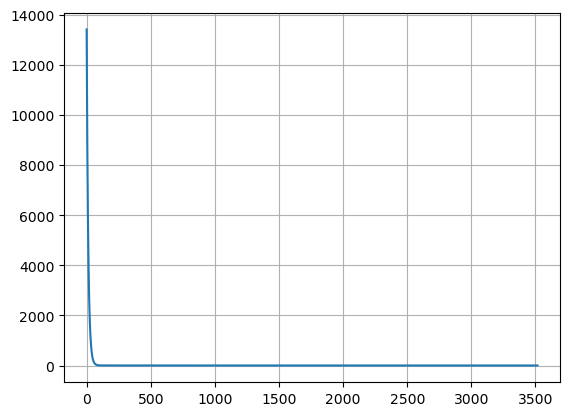

In [249]:
plt.plot(losses)
plt.grid()

#### Use R2 score to evaluate LR equation output

In [218]:
r2_score(y2, predicted_y2)

0.9890131164245575